# GAN

In [1]:
import librosa
import io
import os
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import Audio

import torch
import torch.nn as nn
import torch.optim as optim

import librosa
import librosa.display
import IPython.display as ipd
import soundfile as sf

In [2]:
path = os.getcwd()
folder_path = f'{path}/data'

In [3]:
parquet_file_path = f'data/train-00000-of-00016-6b5481c76a3d2702.parquet'

# Load the data into a pandas DataFrame
df = pd.read_parquet(parquet_file_path, engine='pyarrow')

In [4]:
df.head()

,audio,song_id,genre_id,genre
0,{'bytes': b'OggS\x00\x02\x00\x00\x00\x00\x00\x...,0,0,Electronic
1,{'bytes': b'OggS\x00\x02\x00\x00\x00\x00\x00\x...,1,9,International
2,{'bytes': b'OggS\x00\x02\x00\x00\x00\x00\x00\x...,2,6,Chiptune / Glitch
3,{'bytes': b'OggS\x00\x02\x00\x00\x00\x00\x00\x...,4,4,Hip-Hop
4,{'bytes': b'OggS\x00\x02\x00\x00\x00\x00\x00\x...,5,14,Country


In [5]:
# Reproducio audio
audio_bytes = df.loc[df['song_id'] == 0, 'audio'].values[0]['bytes']

# Reproducir el audio
Audio(audio_bytes)

In [6]:
def decode_audio(binary_data):
    # Convert bytes to file-like object
    audio_file = io.BytesIO(binary_data)
    
    # Load audio file using librosa
    y, sr = librosa.load(audio_file, sr=None)  # `sr=None` to keep the original sampling rate
    
    return y, sr

In [7]:
# Decode audio for each row in the DataFrame
df['decoded_audio'] = df['audio'].apply(lambda x: decode_audio(x['bytes']))

# Example of how to access the decoded audio and sampling rate
decoded_audio, sampling_rate = df['decoded_audio'][0]  # Accessing the first row as an example
print(f"Decoded Audio: {decoded_audio}")
print(f"Sampling Rate: {sampling_rate}")

# If you want to extract just the time series (audio data) and store it separately
df['audio_time_series'] = df['decoded_audio'].apply(lambda x: x[0])  # Extract time series data
df['sampling_rate'] = df['decoded_audio'].apply(lambda x: x[1])  # Extract sampling rate

Decoded Audio: [ 3.97139956e-07  7.30310489e-07  7.56406735e-07 ... -1.19636685e-01
 -1.16811872e-01 -1.12441733e-01]
Sampling Rate: 44100


In [8]:
df = df.drop('decoded_audio', axis=1)
df = df.drop('audio', axis=1)

Longitudes únicas de audios: [ 660719 1321967 1323119 1439471]
Longitud 660719: 2 ejemplos
Longitud 1321967: 661 ejemplos
Longitud 1323119: 531 ejemplos
Longitud 1439471: 51 ejemplos
Sampling Rate únicos de audios: [22050 44100 48000]
Longitud 22050: 2 ejemplos
Longitud 44100: 1192 ejemplos
Longitud 48000: 51 ejemplos


<function matplotlib.pyplot.show(close=None, block=None)>

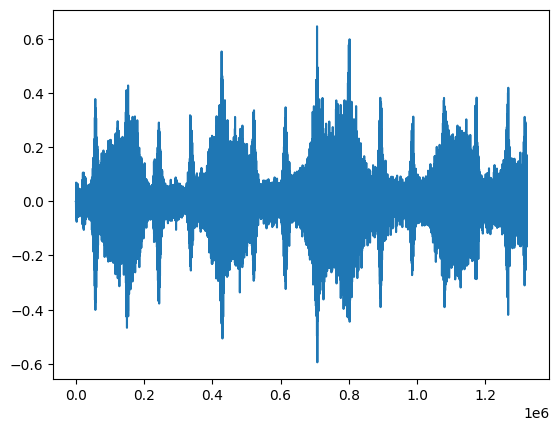

In [9]:
# Calculate the length of each audio time series
lens = [len(ts) for ts in df['audio_time_series']]
# Find unique lengths and their counts
unique_lengths, counts_len = np.unique(lens, return_counts=True)
# Print unique lengths and the number of examples for each length
print(f"Longitudes únicas de audios: {unique_lengths}")
for length, count in zip(unique_lengths, counts_len):
    print(f"Longitud {length}: {count} ejemplos")

unique_sr, counts_sr = np.unique(df.sampling_rate, return_counts=True)
# Print unique lengths and the number of examples for each sampling rate
print(f"Sampling Rate únicos de audios: {unique_sr}")
for length, count in zip(unique_sr, counts_sr):
    print(f"Longitud {length}: {count} ejemplos")


plt.plot(df.audio_time_series[10])
plt.show

# Creacion y filtros usando STFT

In [3]:
df['len_time_series'] = df['audio_time_series'].apply(len)
df

NameError: name 'df' is not defined

In [11]:
# dejamos solo el sampling rate en 44100
df = df[
    df["sampling_rate"] == 44100
].copy(deep=True)

In [12]:
MAX_LENGTH = 1321967
df = df[
    df["len_time_series"] == MAX_LENGTH
].copy(deep=True)

In [13]:
df = df[:50]

In [14]:
import librosa
import numpy as np

def audio_to_stft(audio_time_series, sr=44100, n_fft=1024, hop_length=512):
    """
    Convierte un audio time series a un STFT.

    Parámetros:
    audio_time_series (numpy array): Audio time series.
    sr (int): Frecuencia de muestreo (default=44100).
    n_fft (int): Tamaño de la ventana de Fourier (default=2048).
    hop_length (int): Longitud del salto entre ventanas (default=512).

    Retorna:
    stft (numpy array): STFT del audio.
    """
    stft = librosa.stft(audio_time_series, n_fft=n_fft, hop_length=hop_length)
    return stft

df['stft2'] = df.apply(lambda row: audio_to_stft(row['audio_time_series']), axis=1)

In [15]:
df['stft2'].iloc[0].shape

(513, 2582)

In [16]:
# Función para convertir audio_time_series a STFT
def compute_stft(audio_time_series, sampling_rate):
    # Computar STFT
    stft_result = librosa.stft(audio_time_series, n_fft=1024, hop_length=512)
    # Convertir amplitud a decibelios (dB)
    stft_db = librosa.amplitude_to_db(np.abs(stft_result), ref=np.max)
    return stft_db

# Aplicar la función a cada fila del DataFrame
df['stft'] = df.apply(lambda row: compute_stft(row['audio_time_series'], row['sampling_rate']), axis=1)

# Mostrar el DataFrame resultante
df[['song_id', 'genre', 'stft']]

,song_id,genre,stft
1,1,International,"[[-23.990166, -21.629631, -28.079351, -28.2595..."
2,2,Chiptune / Glitch,"[[-66.10268, -15.176613, -30.658028, -4.897377..."
5,7,Old-Time / Historic,"[[-80.0, -80.0, -69.70636, -64.39059, -62.0941..."
6,9,Hip-Hop,"[[-41.5159, -29.582651, -13.4792595, -40.11945..."
8,12,Electronic,"[[-22.597374, -22.59978, -23.434284, -34.92, -..."
10,14,Experimental,"[[-49.74848, -30.508219, -33.2244, -41.360092,..."
11,15,Blues,"[[-80.0, -80.0, -80.0, -80.0, -73.488335, -78...."
12,16,Hip-Hop,"[[-78.19925, -20.426624, -35.6457, -19.65964, ..."
13,18,International,"[[-33.97943, -41.025253, -37.297527, -38.93386..."
15,20,Hip-Hop,"[[-32.050148, -20.662586, -40.60848, -26.24223..."


In [17]:
df['stft'].iloc[0].shape

(513, 2582)

# Model

## Arquitectura

In [18]:
class Generator(nn.Module):
    def __init__(self, noise_dim, output_channels):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(noise_dim, 1024, kernel_size=(4, 4), stride=(1, 1), padding=0),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(True),
            
            nn.ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(True),
            
            nn.ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(True),
            
            nn.ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(True),
            
            nn.ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 4), padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(True),
            
            nn.ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 4), padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(True),
            
            nn.ConvTranspose2d(32, output_channels, kernel_size=(4, 4), stride=(2, 5), padding=2, output_padding=(1, 1)),
            #nn.ConvTranspose2d(32, output_channels, kernel_size=(8, 45), stride=(4, 20), padding=2, output_padding=(1, 1)),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = x.view(-1, x.size(1), 1, 1)
        return self.model(x)

In [94]:
from torchsummary import summary
noise_dim = 128
output_channels = 1
model = Generator(noise_dim, output_channels)
summary(model, input_size=(128, 1, 1))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1           [-1, 1024, 4, 4]       2,098,176
       BatchNorm2d-2           [-1, 1024, 4, 4]           2,048
         LeakyReLU-3           [-1, 1024, 4, 4]               0
   ConvTranspose2d-4            [-1, 512, 8, 8]       8,389,120
       BatchNorm2d-5            [-1, 512, 8, 8]           1,024
         LeakyReLU-6            [-1, 512, 8, 8]               0
   ConvTranspose2d-7          [-1, 256, 16, 16]       2,097,408
       BatchNorm2d-8          [-1, 256, 16, 16]             512
         LeakyReLU-9          [-1, 256, 16, 16]               0
  ConvTranspose2d-10          [-1, 128, 32, 32]         524,416
      BatchNorm2d-11          [-1, 128, 32, 32]             256
        LeakyReLU-12          [-1, 128, 32, 32]               0
  ConvTranspose2d-13          [-1, 64, 64, 126]         131,136
      BatchNorm2d-14          [-1, 64, 

In [109]:
class Generator(nn.Module):
    def __init__(self, noise_dim, output_channels):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(noise_dim, 1024, kernel_size=4, stride=1, padding=0),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(32, output_channels, kernel_size=(6, 43), stride=(4, 20), padding=1, output_padding=(1, 1)),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = x.view(-1, x.size(1), 1, 1)
        return self.model(x)

# Parámetros del generador
noise_dim = 100
output_channels = 1

# Inicializar el generador
generator = Generator(noise_dim, output_channels)

# Probar el generador con un input aleatorio
noise = torch.randn(1, noise_dim, 1, 1)
fake_stft = generator(noise)
print(fake_stft.shape)  # Esto debería dar (1, 1, 513, 2582)

torch.Size([1, 1, 513, 2582])


In [ ]:
(513, 2582)


In [80]:
class Generator(nn.Module):
    def __init__(self, noise_dim, output_channels, output_size):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(noise_dim, 1024, kernel_size=(4, 4), stride=(1, 1), padding=0),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(32, output_channels, kernel_size=(7, 8), stride=(4, 4), padding=(2, 1), output_padding=(1, 1)),
            nn.Tanh()
        )

    def forward(self, x):
        x = x.view(-1, x.size(1), 1, 1)
        return self.model(x)

# Parámetros de prueba
noise_dim = 100
output_channels = 1
output_size = (1, 1025, 2582)

# Inicializar el generador
generator = Generator(noise_dim, output_channels, output_size)

# Probar el generador con un input aleatorio
noise = torch.randn(1, noise_dim, 1, 1)
fake_stft = generator(noise)
print(fake_stft.shape)

torch.Size([1, 1, 512, 515])


## Modelo

In [2]:
from dataset.modules.music_dataset import TorchMusicDataset
dataset = TorchMusicDataset("cleaned_data")
obj = dataset.__getitem__(0)

dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])


In [3]:
obj

{'song_id': tensor(6906),
 'genre_id': tensor(5),
 'time_series': tensor([-5.6590e-10, -4.9311e-09, -9.3722e-09,  ..., -1.1531e-01,
         -1.0835e-01, -1.0263e-01])}

In [4]:
len(obj['time_series'])

1321967

In [5]:
def audio_to_stft(audio_time_series, sr=44100, n_fft=1024, hop_length=512):
    """
    Convierte un audio time series a un STFT.

    Parámetros:
    audio_time_series (numpy array): Audio time series.
    sr (int): Frecuencia de muestreo (default=44100).
    n_fft (int): Tamaño de la ventana de Fourier (default=2048).
    hop_length (int): Longitud del salto entre ventanas (default=512).

    Retorna:
    stft (numpy array): STFT del audio.
    """
    stft = librosa.stft(audio_time_series, n_fft=n_fft, hop_length=hop_length)
    return stft

In [6]:
from dataset.modules.music_dataset import TorchMusicDataset

dataset = TorchMusicDataset("cleaned_data")
songs = []
for i in range(700):
    obj = dataset.__getitem__(i)
    song = audio_to_stft(obj['time_series'].numpy(), sr=44100, n_fft=1024, hop_length=512)
    # song = obj['time_series'].numpy()[:-7]
    songs.append(song)

dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])
dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])
dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])
dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])
dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])
dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])
dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])
dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])
dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])
dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])
dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])
dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])
dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])
dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])
dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])
dict_keys(['song_id', 'genre_id', 'genre', 'time_series'])
dict_keys(['song_id', 'genre_id', 'genre', 'time_series'

In [7]:
del dataset, obj

In [5]:
len(songs)

700

In [8]:
import torch
import torch.nn as nn
import torch.optim as optim
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
import pickle

In [36]:
# Concatenar todas las STFTs para calcular la media y la desviación estándar generales
all_stfts = torch.cat([torch.tensor(stft, dtype=torch.float32).unsqueeze(0) for stft in songs], dim=0)

# Calcular la media y la desviación estándar generales
global_mean = all_stfts.mean()
global_std = all_stfts.std()

print(f"Global Mean: {global_mean.item()}, Global Std: {global_std.item()}")

# Convertir STFTs a tensores y normalizar usando la media y la desviación estándar globales
def prepare_stft_tensor(stft, mean, std):
    stft_tensor = torch.tensor(stft, dtype=torch.float32)
    stft_tensor = (stft_tensor - mean) / std
    stft_tensor = stft_tensor.unsqueeze(0).unsqueeze(0)  # Añadir dimensiones para canales y batch
    return stft_tensor

# Aplicar la normalización a cada STFT en el array
stft_tensors = [prepare_stft_tensor(stft, global_mean, global_std) for stft in songs]

# Guardar la media y la desviación estándar globales para uso posterior
with open('global_stft_stats.pkl', 'wb') as f:
    pickle.dump({'mean': global_mean.item(), 'std': global_std.item()}, f)

Global Mean: 0.00039325247053056955, Global Std: 2.989069938659668


In [39]:
# Desnormalizar los STFTs generados
def denormalize_stft(stft, mean, std):
    return stft * std + mean

In [114]:
# Concatenar todas las STFTs para calcular la media y la desviación estándar generales
all_stfts = torch.cat([torch.tensor(stft, dtype=torch.float32).unsqueeze(0) for stft in df['stft']], dim=0)

# Calcular la media y la desviación estándar generales
global_mean = all_stfts.mean()
global_std = all_stfts.std()

print(f"Global Mean: {global_mean.item()}, Global Std: {global_std.item()}")

# Convertir STFTs a tensores y normalizar usando la media y la desviación estándar globales
def prepare_stft_tensor(stft, mean, std):
    stft_tensor = torch.tensor(stft, dtype=torch.float32)
    stft_tensor = (stft_tensor - mean) / std
    stft_tensor = stft_tensor.unsqueeze(0).unsqueeze(0)  # Añadir dimensiones para canales y batch
    return stft_tensor

df['stft_tensor'] = df['stft'].apply(lambda x: prepare_stft_tensor(x, global_mean, global_std))

# Guardar la media y la desviación estándar globales para uso posterior
with open('global_stft_stats.pkl', 'wb') as f:
    pickle.dump({'mean': global_mean.item(), 'std': global_std.item()}, f)
    
# Desnormalizar los STFTs generados
def denormalize_stft(stft, mean, std):
    return stft * std + mean

Global Mean: -63.695640563964844, Global Std: 17.613527297973633


In [115]:
class Generator(nn.Module):
    def __init__(self, noise_dim, output_channels):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(noise_dim, 1024, kernel_size=4, stride=1, padding=0),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(32, output_channels, kernel_size=(6, 43), stride=(4, 20), padding=1, output_padding=(1, 1)),
            nn.tanh()
        )

    def forward(self, x):
        x = x.view(-1, x.size(1), 1, 1)
        return self.model(x)

# Definir la clase Discriminator
class Discriminator(nn.Module):
    def __init__(self, input_channels):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(input_channels, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.model(x)

# Parámetros de STFT
n_fft = 1024
hop_length = 512

# Parámetros del GAN
noise_dim = 100
output_channels = 1  # 1 canal porque es magnitud de STFT

# Obtener dimensiones de frecuencia y tiempo
frecuencia_dim = n_fft // 2 + 1

# Asegúrate de que las dimensiones de STFT sean correctas
frecuencia_dim = df['stft'].iloc[0].shape[0]
tiempo_dim = df['stft'].iloc[0].shape[1]
output_size = (1, frecuencia_dim, tiempo_dim)

# Inicializar modelos
generator = Generator(noise_dim, output_channels)
discriminator = Discriminator(output_channels)

# Optimizadores
optimizer_G = optim.Adam(generator.parameters(), lr=0.0001, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Función de pérdida
criterion = nn.BCELoss()

# Crear DataLoader para entrenamiento
batch_size = 8
train_loader = torch.utils.data.DataLoader(df['stft_tensor'].tolist(), batch_size=batch_size, shuffle=True)

# Inicializa listas para almacenar las pérdidas
d_losses = []
g_losses = []

# Entrenamiento
num_epochs = 20
for epoch in range(num_epochs):
    for real_stfts in train_loader:
        real_stfts = real_stfts.squeeze(2).squeeze(2)  # Ajustar las dimensiones para que sean [batch_size, channels, height, width]
        batch_size = real_stfts.size(0)
        
        # Forward pass del discriminador con datos reales
        real_outputs = discriminator(real_stfts)
        real_labels = torch.ones_like(real_outputs)  # Ajustar el tamaño de real_labels
        d_loss_real = criterion(real_outputs, real_labels)
        
        # Generar datos falsos y forward pass del discriminador
        noise = torch.randn(batch_size, noise_dim, 1, 1)
        fake_stfts = generator(noise)
        fake_outputs = discriminator(fake_stfts.detach())
        fake_labels = torch.zeros_like(fake_outputs)  # Ajustar el tamaño de fake_labels
        d_loss_fake = criterion(fake_outputs, fake_labels)
        
        # Pérdida total y actualización del discriminador
        d_loss = d_loss_real + d_loss_fake
        optimizer_D.zero_grad()
        d_loss.backward()
        optimizer_D.step()
        
        # Entrenar Generador
        optimizer_G.zero_grad()
        fake_outputs = discriminator(fake_stfts)
        g_loss = criterion(fake_outputs, torch.ones_like(fake_outputs))  # Usar real_labels para que el generador aprenda a generar datos reales
        g_loss.backward()
        optimizer_G.step()
        
    # Guardar las pérdidas
    d_losses.append(d_loss.item())
    g_losses.append(g_loss.item())
    
    print(f"Epoch [{epoch+1}/{num_epochs}], d_loss: {d_loss.item()}, g_loss: {g_loss.item()}")

Epoch [1/20], d_loss: 0.5971661806106567, g_loss: 1.7995778322219849
Epoch [2/20], d_loss: 0.1583157181739807, g_loss: 3.1539218425750732
Epoch [3/20], d_loss: 0.2312609851360321, g_loss: 3.625058174133301
Epoch [4/20], d_loss: 0.06940656155347824, g_loss: 4.397538661956787
Epoch [5/20], d_loss: 0.0354338064789772, g_loss: 4.395760536193848
Epoch [6/20], d_loss: 0.0270649716258049, g_loss: 4.810179233551025
Epoch [7/20], d_loss: 0.020720349624753, g_loss: 4.798206806182861
Epoch [8/20], d_loss: 0.02095693349838257, g_loss: 4.940546035766602
Epoch [9/20], d_loss: 0.017735380679368973, g_loss: 5.0113749504089355
Epoch [10/20], d_loss: 0.01196800172328949, g_loss: 5.770208358764648
Epoch [11/20], d_loss: 0.0088295703753829, g_loss: 5.7154154777526855
Epoch [12/20], d_loss: 0.009647216647863388, g_loss: 5.676967620849609
Epoch [13/20], d_loss: 0.007550605572760105, g_loss: 6.041701793670654
Epoch [14/20], d_loss: 0.006442820653319359, g_loss: 6.043881416320801
Epoch [15/20], d_loss: 0.0048

In [116]:
# Generar un ejemplo a partir del ruido
noise = torch.randn(1, noise_dim, 1, 1)
generated_stft = generator(noise).detach().numpy()
generated_stft = generated_stft.squeeze()

In [117]:
generated_stft.shape

(513, 2582)

In [118]:
print(f"real_stfts.shape: {real_stfts.shape}")
print(f"real_outputs.shape: {real_outputs.shape}")
print(f"real_labels.shape: {real_labels.shape}")
print(f"fake_stfts.shape: {fake_stfts.shape}")
print(f"fake_outputs.shape: {fake_outputs.shape}")
print(f"fake_labels.shape: {fake_labels.shape}")

real_stfts.shape: torch.Size([2, 1, 513, 2582])
real_outputs.shape: torch.Size([2, 1, 13, 77])
real_labels.shape: torch.Size([2, 1, 13, 77])
fake_stfts.shape: torch.Size([2, 1, 513, 2582])
fake_outputs.shape: torch.Size([2, 1, 13, 77])
fake_labels.shape: torch.Size([2, 1, 13, 77])


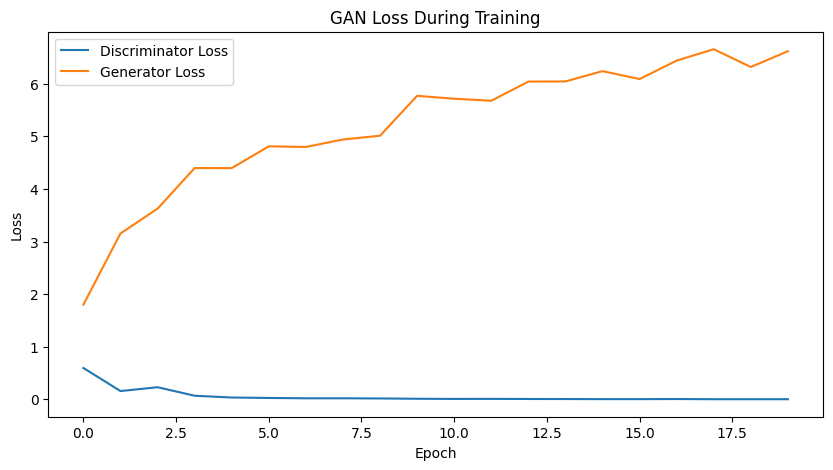

In [119]:
# Graficar las pérdidas
plt.figure(figsize=(10, 5))
plt.plot(d_losses, label='Discriminator Loss')
plt.plot(g_losses, label='Generator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('GAN Loss During Training')
plt.show()

In [121]:
# Desnormalizar los STFTs generados
def denormalize_stft(stft, mean, std):
    return stft * std + mean

In [125]:
global_mean.item()

-63.695640563964844

In [ ]:
denormalized_output = denormalize(output, mean, std)

In [127]:
noise = torch.randn(1, noise_dim, 1, 1)
generated_stft = generator(noise).detach().numpy()
generated_stft = generated_stft.squeeze()
generated_stft = denormalize_stft(generated_stft, global_mean.item(), global_std.item())
generated_stft.shape

(513, 2582)

In [38]:
# Cargar los valores de media y desviación estándar
#with open('stft_stats.pkl', 'rb') as f:
#    stft_stats = pickle.load(f)

def denormalize_stft(stft, index):
    mean = stft_stats[index]['mean']
    std = stft_stats[index]['std']
    return stft * std + mean

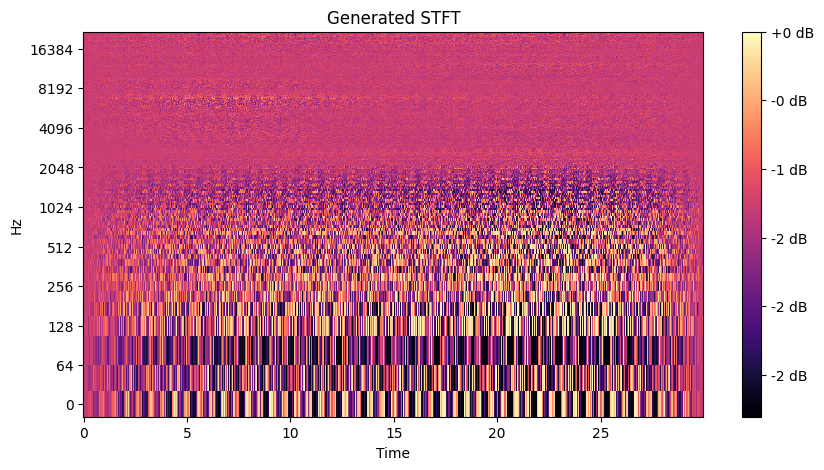

In [128]:
import librosa
import librosa.display
import soundfile as sf

sr = 44100

# Generar un ejemplo a partir del ruido
noise = torch.randn(1, noise_dim, 1, 1)
generated_stft = generator(noise).detach().numpy()
generated_stft = generated_stft.squeeze()
generated_stft = denormalize_stft(generated_stft, global_mean.item(), global_std.item())

# Graficar el STFT generado
plt.figure(figsize=(10, 5))
librosa.display.specshow(librosa.amplitude_to_db(generated_stft, ref=np.max), sr=sr, hop_length=hop_length, y_axis='log', x_axis='time')
plt.title('Generated STFT')
plt.colorbar(format='%+2.0f dB')
plt.show()

# Convertir el STFT generado de vuelta a una señal de audio
def istft(stft_matrix, hop_length, win_length):
    return librosa.istft(stft_matrix, hop_length=hop_length, win_length=win_length)

generated_audio = istft(generated_stft, hop_length=hop_length, win_length=hop_length)

# Guardar el audio generado
# librosa.output.write_wav('generated_audio.wav', generated_audio, sr=22050)
sf.write('generated_audio.wav', generated_audio, samplerate=sr)


# Reproducir el audio generado
import IPython.display as ipd
ipd.Audio(generated_audio, rate=sr)

In [29]:
import numpy as np
import librosa
import librosa.display
import IPython.display as ipd

# Parámetros de STFT y audio original
n_fft = 1024
hop_length = 512
sr = 44100  # Frecuencia de muestreo

# Suponiendo que generated_stft es la matriz STFT generada por el modelo
# generated_stft = generated_stft.squeeze()  # Eliminar dimensiones adicionales si las hay

# Convertir STFT a audio usando librosa
generated_audio = librosa.istft(generated_stft, hop_length=hop_length, win_length=n_fft)

# Guardar el audio generado
# librosa.output.write_wav('generated_audio.wav', generated_audio, sr=sr)
sf.write('generated_audio.wav', generated_audio, samplerate=sr)

# Reproducir el audio generado
ipd.Audio('generated_audio.wav')

NameError: name 'generated_stft' is not defined

In [83]:
import numpy as np
import librosa
import librosa.display
import IPython.display as ipd
import soundfile as sf

# Parámetros de STFT y audio original
n_fft = 1024
hop_length = 512
sr = 44100  # Frecuencia de muestreo

song = songs[1]
# Convertir STFT a audio usando librosa
song = librosa.istft(song, hop_length=hop_length, win_length=n_fft)

sf.write('generated_audio.wav', song, samplerate=sr)

# Reproducir el audio generado
ipd.Audio('generated_audio.wav')

In [45]:
song[0].shape

(1, 1321472)

In [52]:
song = stft_tensors[0].numpy()

song = denormalize_stft(song, global_mean.item(), global_std.item())


song = librosa.istft(song, hop_length=hop_length, win_length=n_fft)
song.shape

(1, 1, 1321472)

In [82]:
song = stft_tensors[1].squeeze().numpy()

song = denormalize_stft(song, global_mean.item(), global_std.item())


song = librosa.istft(song, hop_length=hop_length, win_length=n_fft)

sf.write('generated_audio.wav', song, samplerate=sr)

# Reproducir el audio generado
ipd.Audio('generated_audio.wav')

In [42]:
stft_tensors[0].shape

torch.Size([1, 1, 513, 2582])

In [55]:
song = stft_tensors[1].squeeze().numpy()  # Eliminar dimensiones adicionales

# Desnormalizar el STFT
def denormalize_stft(stft, mean, std):
    return stft * std + mean

# Desnormalizar
song = denormalize_stft(song, global_mean.item(), global_std.item())

# Verificar la forma del STFT antes de convertirlo a audio
print(f"STFT shape before istft: {song.shape}")

# Convertir STFT a audio
audio = librosa.istft(song, hop_length=hop_length, win_length=n_fft)

# Guardar el audio generado
sf.write('generated_audio.wav', audio, samplerate=sr)

# Reproducir el audio generado
ipd.Audio('generated_audio.wav')

STFT shape before istft: (513, 2582)


In [59]:
# Concatenar todas las STFTs para calcular la media y la desviación estándar generales
all_stfts = torch.cat([torch.tensor(stft, dtype=torch.float32).unsqueeze(0) for stft in songs], dim=0)

# Calcular la media y la desviación estándar generales
global_mean = all_stfts.mean()
global_std = all_stfts.std()

print(f"Global Mean: {global_mean.item()}, Global Std: {global_std.item()}")

# Convertir STFTs a tensores y normalizar usando la media y la desviación estándar globales
def prepare_stft_tensor(stft, mean, std):
    stft_tensor = torch.tensor(stft, dtype=torch.float32)
    stft_tensor = (stft_tensor - mean) / std
    stft_tensor = stft_tensor.unsqueeze(0).unsqueeze(0)  # Añadir dimensiones para canales y batch
    return stft_tensor

stft_tensors = [prepare_stft_tensor(stft, global_mean, global_std) for stft in songs]

# Guardar la media y la desviación estándar globales para uso posterior
with open('global_stft_stats.pkl', 'wb') as f:
    pickle.dump({'mean': global_mean.item(), 'std': global_std.item()}, f)

Global Mean: 0.00039325247053056955, Global Std: 2.989069938659668


In [80]:
# Seleccionar una muestra generada
generated_stft = stft_tensors[1].squeeze().numpy()

# Desnormalizar
generated_stft = denormalize_stft(generated_stft, global_mean.item(), global_std.item())

# Verificar la forma del STFT antes de la conversión
print(f"STFT shape before istft: {generated_stft.shape}")

# Convertir STFT a audio
audio = librosa.istft(generated_stft, hop_length=hop_length, win_length=n_fft)

# Guardar el audio generado
sf.write('generated_audio.wav', audio, samplerate=sr)

# Reproducir el audio generado
ipd.Audio('generated_audio.wav')

STFT shape before istft: (513, 2582)


In [63]:
# Datos de ejemplo
sr = 22050
hop_length = 512
n_fft = 1024

# Concatenar todas las STFTs para calcular la media y la desviación estándar generales
all_stfts = torch.cat([torch.tensor(stft, dtype=torch.float32).unsqueeze(0) for stft in songs], dim=0)

# Calcular la media y la desviación estándar generales
global_mean = all_stfts.mean()
global_std = all_stfts.std()

print(f"Global Mean: {global_mean.item()}, Global Std: {global_std.item()}")

# Convertir STFTs a tensores y normalizar usando la media y la desviación estándar globales
def prepare_stft_tensor(stft, mean, std):
    stft_tensor = torch.tensor(stft, dtype=torch.float32)
    stft_tensor = (stft_tensor - mean) / std
    stft_tensor = stft_tensor.unsqueeze(0).unsqueeze(0)  # Añadir dimensiones para canales y batch
    return stft_tensor

stft_tensors_normalized = [prepare_stft_tensor(stft, global_mean, global_std) for stft in songs]

# Desnormalizar el STFT
def denormalize_stft(stft, mean, std):
    return stft * std + mean

# Tomar una STFT normalizada y desnormalizarla
song_normalized = stft_tensors_normalized[0].squeeze().numpy()  # Eliminar dimensiones adicionales
song = denormalize_stft(song_normalized, global_mean.item(), global_std.item())

# Verificar la forma del STFT antes de convertirlo a audio
print(f"STFT shape before istft: {song.shape}")

# Convertir STFT a audio
audio = librosa.istft(song, hop_length=hop_length, win_length=n_fft)

# Guardar el audio generado
sf.write('generated_audio.wav', audio, samplerate=sr)

# Reproducir el audio generado
ipd.Audio('generated_audio.wav')

# Visualizar las formas de onda de la señal original y la reconstruida para comparar
original_audio = librosa.istft(stft_example, hop_length=hop_length, win_length=n_fft)
plt.figure(figsize=(12, 6))

plt.subplot(2, 1, 1)
plt.plot(original_audio)
plt.title('Original Audio')

plt.subplot(2, 1, 2)
plt.plot(audio)
plt.title('Reconstructed Audio')

plt.tight_layout()
plt.show()

Global Mean: 0.00039325247053056955, Global Std: 2.989069938659668
STFT shape before istft: (513, 2582)


NameError: name 'stft_example' is not defined

In [72]:

# Datos de ejemplo
sr = 44100
hop_length = 512
n_fft = 1024


# Ejemplo STFT tensor
song = songs[1]

# Calcular la media y desviación estándar globales
global_mean = song.mean()
global_std = song.std()

print(f"Global Mean: {global_mean.item()}, Global Std: {global_std.item()}")

# Función para estandarizar el STFT
def standardize_stft(stft, mean, std):
    return (stft - mean) / std

# Función para desestandarizar el STFT
def denormalize_stft(stft, mean, std):
    return stft * std + mean

# Estandarizar
standardized_stft = standardize_stft(song, global_mean, global_std)

# Desestandarizar
denormalized_stft = denormalize_stft(song, global_mean, global_std)

# Convertir a numpy para la función istft
denormalized_stft_np = denormalized_stft.squeeze()

# Verificar que la forma sea la correcta
print(f"Shape after desestandarizar: {denormalized_stft_np.shape}")

# Convertir STFT a audio
audio = librosa.istft(denormalized_stft_np, hop_length=hop_length, win_length=n_fft)

# Guardar el audio generado
sf.write('reconstructed_audio.wav', audio, samplerate=sr)

# Reproducir el audio generado
ipd.Audio('reconstructed_audio.wav')

Global Mean: (-2.694760223675985e-05+1.931980932567967e-06j), Global Std: 4.420897960662842
Shape after desestandarizar: (513, 2582)


In [74]:
songs[1].shape

(513, 2582)

In [ ]:
# Parámetros de STFT y audio original
n_fft = 1024
hop_length = 512
sr = 44100  # Frecuencia de muestreo

# Concatenar todas las STFTs para calcular la media y la desviación estándar generales
all_stfts = torch.cat([torch.tensor(stft, dtype=torch.float32).unsqueeze(0) for stft in songs], dim=0)

# Calcular la media y la desviación estándar generales
global_mean = all_stfts.mean()
global_std = all_stfts.std()

del all_stfts

print(f"Global Mean: {global_mean.item()}, Global Std: {global_std.item()}")

# Convertir STFTs a tensores y normalizar usando la media y la desviación estándar globales
def prepare_stft_tensor(stft, mean, std):
    #stft_tensor = torch.tensor(stft, dtype=torch.float32)
    stft_tensor = stft
    stft_tensor = (stft_tensor - mean) / std
    #stft_tensor = stft_tensor.unsqueeze(0).unsqueeze(0)  # Añadir dimensiones para canales y batch
    return stft_tensor

# Aplicar la normalización a cada STFT en el array
stft_tensors = [prepare_stft_tensor(stft, global_mean.item(), global_std.item()) for stft in songs]

song = stft_tensors[1]
# denormalized_stft = denormalize_stft(song, global_mean, global_std).numpy()
denormalized_stft = denormalize_stft(song, global_mean.item(), global_std.item())


# Convertir a numpy para la función istft
denormalized_stft_np = denormalized_stft.squeeze()

# Verificar que la forma sea la correcta
print(f"Shape after desestandarizar: {denormalized_stft_np.shape}")

# Convertir STFT a audio
audio = librosa.istft(denormalized_stft_np, hop_length=hop_length, win_length=n_fft)

# Guardar el audio generado
sf.write('reconstructed_audio.wav', audio, samplerate=sr)

# Reproducir el audio generado
ipd.Audio('reconstructed_audio.wav')

Global Mean: 0.00039325247053056955, Global Std: 2.989069938659668


In [86]:
# Parámetros de STFT y audio original
n_fft = 1024
hop_length = 512
sr = 44100  # Frecuencia de muestreo

# Concatenar todas las STFTs para calcular la media y la desviación estándar generales
all_stfts = torch.cat([torch.tensor(stft, dtype=torch.float32).unsqueeze(0) for stft in songs], dim=0)

# Calcular la media y la desviación estándar generales
global_mean = all_stfts.mean()
global_std = all_stfts.std()

del all_stfts

print(f"Global Mean: {global_mean.item()}, Global Std: {global_std.item()}")

# Convertir STFTs a tensores y normalizar usando la media y la desviación estándar globales
def prepare_stft_tensor(stft, mean, std):
    stft_tensor = torch.tensor(stft, dtype=torch.float32)
    stft_tensor = (stft_tensor - mean) / std
    stft_tensor = stft_tensor.unsqueeze(0).unsqueeze(0)  # Añadir dimensiones para canales y batch
    return stft_tensor

# Aplicar la normalización a cada STFT en el array
stft_tensors = [prepare_stft_tensor(stft, global_mean, global_std) for stft in songs]


Global Mean: 0.00039325247053056955, Global Std: 2.989069938659668


In [87]:
song = stft_tensors[1]
denormalized_stft = denormalize_stft(song, global_mean, global_std).numpy()


# Convertir a numpy para la función istft
denormalized_stft_np = denormalized_stft.squeeze()

# Verificar que la forma sea la correcta
print(f"Shape after desestandarizar: {denormalized_stft_np.shape}")

# Convertir STFT a audio
audio = librosa.istft(denormalized_stft_np, hop_length=hop_length, win_length=n_fft)

# Guardar el audio generado
sf.write('reconstructed_audio.wav', audio, samplerate=sr)

# Reproducir el audio generado
ipd.Audio('reconstructed_audio.wav')

Shape after desestandarizar: (513, 2582)


In [30]:
import numpy as np
import librosa
import librosa.display
import IPython.display as ipd
import soundfile as sf

# Parámetros de STFT y audio original
n_fft = 1024
hop_length = 512
sr = 44100  # Frecuencia de muestreo


# Normalización alternativa entre 0 y 1
def prepare_stft_tensor_minmax(stft):
    #stft_tensor = torch.tensor(stft, dtype=torch.float64)
    #stft_tensor = torch.tensor(stft)
    stft_tensor = stft
    
    stft_tensor_min = stft_tensor.min()
    stft_tensor_max = stft_tensor.max()
    stft_tensor = (stft_tensor - stft_tensor_min) / (stft_tensor_max - stft_tensor_min)
    return stft_tensor, stft_tensor_min, stft_tensor_max

# Desnormalización alternativa
def denormalize_stft_minmax(stft, min_val, max_val):
    return stft * (max_val - min_val) + min_val

# Aplicar la normalización alternativa a cada STFT en el array
stft_tensors = []
min_vals = []
max_vals = []
for stft in songs:
    norm_stft, stft_min, stft_max = prepare_stft_tensor_minmax(stft)
    stft_tensors.append(norm_stft)
    min_vals.append(stft_min)
    max_vals.append(stft_max)

# Desnormalizar y reconstruir audio para verificación
song = stft_tensors[1]
#denormalized_stft = denormalize_stft_minmax(song, min_vals[1], max_vals[1]).detach().numpy()
denormalized_stft = denormalize_stft_minmax(song, min_vals[1], max_vals[1])

# Convertir a numpy para la función istft
denormalized_stft_np = denormalized_stft.squeeze()

# Verificar que la forma sea la correcta
print(f"Shape after desestandarizar: {denormalized_stft_np.shape}")

# Convertir STFT a audio
audio = librosa.istft(denormalized_stft_np, hop_length=hop_length, win_length=n_fft)

# Guardar el audio generado
sf.write('reconstructed_audio.wav', audio, samplerate=sr)

# Reproducir el audio generado
ipd.Audio('reconstructed_audio.wav')

Shape after desestandarizar: (513, 2582)


In [28]:
songs[0].dtype

dtype('complex64')

In [33]:
import os
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import stft, istft
from scipy.io.wavfile import write

def pad_or_truncate_waveform(waveform, desired_length):
    current_length = len(waveform)
    if current_length < desired_length:
        padding = desired_length - current_length
        waveform = np.pad(waveform, (0, padding), 'constant')
    else:
        waveform = waveform[:desired_length]
    return waveform

def generate_spectrogram(waveform, desired_length, frame_length=256, frame_step=128, fft_length=256):
    waveform = pad_or_truncate_waveform(waveform, desired_length)
    f, t, Zxx = stft(waveform, nperseg=frame_length, noverlap=frame_length - frame_step, nfft=fft_length)
    magnitude = np.abs(Zxx)
    phase = np.angle(Zxx)
    return magnitude, phase

def find_max_length(directory):
    max_length = 0
    for filename in os.listdir(directory):
        if filename.endswith('.npy'):
            file_path = os.path.join(directory, filename)
            example = np.load(file_path, allow_pickle=True).tolist()
            waveform = np.array(example["time_series"], dtype=np.float32)
            if len(waveform) > max_length:
                max_length = len(waveform)
    return max_length

def process_files(directory, output_dir, max_length, frame_length=256, frame_step=128, fft_length=256):
    for filename in os.listdir(directory):
        if filename.endswith('.npy'):
            file_path = os.path.join(directory, filename)
            example = np.load(file_path, allow_pickle=True).tolist()
            waveform = np.array(example["time_series"], dtype=np.float32)
            
            # Generate spectrogram
            magnitude, phase = generate_spectrogram(waveform, max_length, frame_length, frame_step, fft_length)
            
            # Save spectrogram magnitude and phase as .npy
            output_path_magnitude = os.path.join(output_dir, f'{os.path.splitext(filename)[0]}_magnitude.npy')
            output_path_phase = os.path.join(output_dir, f'{os.path.splitext(filename)[0]}_phase.npy')
            np.save(output_path_magnitude, magnitude)
            np.save(output_path_phase, phase)
            print(f'Saved magnitude and phase for {filename} at {output_path_magnitude} and {output_path_phase}')

def spectrogram_to_waveform(magnitude, phase, frame_length=256, frame_step=128, fft_length=256):
    # Combine magnitude and phase to create the complex spectrogram
    Zxx = magnitude * np.exp(1j * phase)
    # Perform inverse STFT to get the waveform back
    _, waveform = istft(Zxx, nperseg=frame_length, noverlap=frame_length - frame_step, nfft=fft_length)
    return waveform

def save_waveform(waveform, save_path, sample_rate=44100):
    # Normalize waveform to the range of int16
    waveform = waveform / np.max(np.abs(waveform))
    waveform = (waveform * 32767).astype(np.int16)
    write(save_path, sample_rate, waveform)

def convert_npy_to_audio(magnitude_path, phase_path, output_wav_path, frame_length=256, frame_step=128, fft_length=256, sample_rate=44100):
    # Load the spectrogram magnitude and phase .npy files
    magnitude = np.load(magnitude_path)
    phase = np.load(phase_path)
    
    # Convert spectrogram back to waveform
    waveform = spectrogram_to_waveform(magnitude, phase, frame_length, frame_step, fft_length)
    
    # Save the waveform as a wav file
    save_waveform(waveform, output_wav_path, sample_rate)
    print(f'Saved waveform to {output_wav_path}')

def plot_spectrogram(magnitude, phase, output_image_prefix):
    # Plot magnitude
    plt.figure(figsize=(12, 6))
    plt.title('Magnitude Spectrogram')
    plt.imshow(np.log(magnitude + 1e-10).T, aspect='auto', origin='lower')
    plt.colorbar(format='%+2.0f dB')
    plt.xlabel('Time Frames')
    plt.ylabel('Frequency Bins')
    plt.tight_layout()
    plt.savefig(f'{output_image_prefix}_magnitude.png')
    plt.close()
    
    # Plot phase
    plt.figure(figsize=(12, 6))
    plt.title('Phase Spectrogram')
    plt.imshow(phase.T, aspect='auto', origin='lower', cmap='hsv')
    plt.colorbar()
    plt.xlabel('Time Frames')
    plt.ylabel('Frequency Bins')
    plt.tight_layout()
    plt.savefig(f'{output_image_prefix}_phase.png')
    plt.close()

if __name__ == "__main__":
    # Parameters
    frame_length = 256
    frame_step = 128
    fft_length = 256

    # Directories
    clean_data_dir = 'cleaned_data'
    output_dir = 'spectrogram_npy'
    os.makedirs(output_dir, exist_ok=True)

    # Step 1: Find the longest audio length in the dataset
    max_length = find_max_length(clean_data_dir)
    print(f'Max length found: {max_length}')

    # Step 2: Process each .npy file and pad/truncate to max_length
    process_files(clean_data_dir, output_dir, max_length, frame_length, frame_step, fft_length)

    # Example usage of converting a spectrogram .npy back to audio
    ex = '254'
    magnitude_path = f'spectrogram_npy/{ex}_magnitude.npy'
    phase_path = f'spectrogram_npy/{ex}_phase.npy'
    output_wav_path = f'reconstructed_{ex}.wav'
    convert_npy_to_audio(magnitude_path, phase_path, output_wav_path)

    # Load the magnitude and phase
    magnitude = np.load(magnitude_path)
    phase = np.load(phase_path)

    # Plot and save the spectrogram images
    plot_spectrogram(magnitude, phase, ex)

Max length found: 1321967
Saved magnitude and phase for 6906.npy at spectrogram_npy/6906_magnitude.npy and spectrogram_npy/6906_phase.npy
Saved magnitude and phase for 1927.npy at spectrogram_npy/1927_magnitude.npy and spectrogram_npy/1927_phase.npy
Saved magnitude and phase for 22529.npy at spectrogram_npy/22529_magnitude.npy and spectrogram_npy/22529_phase.npy
Saved magnitude and phase for 17592.npy at spectrogram_npy/17592_magnitude.npy and spectrogram_npy/17592_phase.npy
Saved magnitude and phase for 8297.npy at spectrogram_npy/8297_magnitude.npy and spectrogram_npy/8297_phase.npy
Saved magnitude and phase for 18851.npy at spectrogram_npy/18851_magnitude.npy and spectrogram_npy/18851_phase.npy
Saved magnitude and phase for 23838.npy at spectrogram_npy/23838_magnitude.npy and spectrogram_npy/23838_phase.npy
Saved magnitude and phase for 2779.npy at spectrogram_npy/2779_magnitude.npy and spectrogram_npy/2779_phase.npy
Saved magnitude and phase for 10570.npy at spectrogram_npy/10570_m

# Espectograma

In [8]:
import numpy as np
import librosa
import torch
import pickle

# Parámetros de STFT y audio
n_fft = 1024
hop_length = 512
sr = 44100  # Frecuencia de muestreo


# Obtener la magnitud del STFT para el espectrograma
spectrograms = [np.abs(stft) for stft in songs]

# Concatenar todos los espectrogramas para calcular la media y desviación estándar globales
all_spectrograms = np.concatenate([spec.flatten() for spec in spectrograms])

# Calcular la media y la desviación estándar globales
global_mean = np.mean(all_spectrograms)
global_std = np.std(all_spectrograms)

del all_spectrograms

print(f"Global Mean: {global_mean}, Global Std: {global_std}")

# Función para normalizar un espectrograma
def normalize_spectrogram(spectrogram, mean, std):
    return (spectrogram - mean) / std

# Normalizar todos los espectrogramas
normalized_spectrograms = [normalize_spectrogram(spec, global_mean, global_std) for spec in spectrograms]

# Convertir a tensores de PyTorch
spectrogram_tensors = [torch.tensor(spec, dtype=torch.float32).unsqueeze(0).unsqueeze(0) for spec in normalized_spectrograms]

# Guardar la media y la desviación estándar globales para uso posterior
with open('global_spectrogram_stats.pkl', 'wb') as f:
    pickle.dump({'mean': global_mean, 'std': global_std}, f)

# Ejemplo de desestandarización de un espectrograma generado
def denormalize_spectrogram(spectrogram, mean, std):
    return spectrogram * std + mean

# Supongamos que `generated_spec` es el espectrograma generado por tu modelo
# Aquí se simula uno de los espectrogramas originales
generated_spec = spectrogram_tensors[1].numpy().squeeze()

# Desestandarizar el espectrograma
denormalized_spec = denormalize_spectrogram(generated_spec, global_mean, global_std)

# Convertir STFT a audio
reconstructed_audio = librosa.istft(denormalized_spec, hop_length=hop_length, win_length=n_fft)

# Guardar el audio generado
import soundfile as sf
sf.write('reconstructed_audio.wav', reconstructed_audio, samplerate=sr)

# Reproducir el audio generado
import IPython.display as ipd
ipd.Audio('reconstructed_audio.wav')

Global Mean: 0.7868581414222717, Global Std: 4.0197672843933105


In [9]:
generated_spec = spectrogram_tensors[1].numpy().squeeze()

# Desestandarizar el espectrograma
denormalized_spec = denormalize_spectrogram(generated_spec, global_mean, global_std)

# Convertir STFT a audio
reconstructed_audio = librosa.istft(denormalized_spec, hop_length=hop_length, win_length=n_fft)

# Guardar el audio generado
import soundfile as sf
sf.write('reconstructed_audio.wav', reconstructed_audio, samplerate=sr)

# Reproducir el audio generado
import IPython.display as ipd
ipd.Audio('reconstructed_audio.wav')

In [11]:
songs

[array([[-1.76779300e-01+0.0000000e+00j,  3.62226665e-01+0.0000000e+00j,
          1.42263681e-01+0.0000000e+00j, ...,
         -5.25185727e-02+0.0000000e+00j,  1.71018749e-01+0.0000000e+00j,
          1.57247603e-01+0.0000000e+00j],
        [-7.14702159e-03-2.1460640e-01j,  2.35165730e-01-5.2506262e-01j,
          5.65078735e-01-3.2310933e-01j, ...,
         -1.54412985e-01-4.1344952e-02j,  3.01999360e-01+5.8638237e-02j,
          1.70889184e-01+3.4698710e-02j],
        [ 2.48836249e-01-1.1240964e-01j, -1.18364429e+00+4.9353719e+00j,
         -1.22441456e-01-1.2061238e+00j, ...,
         -2.01352209e-01+1.8466821e+00j, -3.24313670e-01-5.4490805e-01j,
          1.28878736e+00+1.0522453e-01j],
        ...,
        [ 4.51583162e-07+4.3626660e-08j, -3.84708073e-06+3.9257287e-08j,
          1.89282563e-08-1.4793302e-07j, ...,
         -4.54840468e-08-4.1822065e-07j, -9.26556467e-08-8.2904961e-08j,
         -1.41002572e-04+3.0261130e-05j],
        [-2.91051609e-08+4.7683898e-07j,  4.7190901

# Magnitud y Fase GAN

In [11]:
import numpy as np
import librosa
import librosa.display
import IPython.display as ipd
import soundfile as sf

# Parámetros de STFT y audio
n_fft = 1024
hop_length = 512
sr = 44100  # Frecuencia de muestreo

# Separar magnitud y fase
magnitude_list = [np.abs(stft) for stft in songs]

all_magnitudes = np.concatenate([mag.flatten() for mag in magnitude_list])

global_magnitude_mean = np.mean(all_magnitudes)
global_magnitude_std = np.std(all_magnitudes)

del all_magnitudes


phase_list = [np.angle(stft) for stft in songs]

all_phases = np.concatenate([ph.flatten() for ph in phase_list])

global_phase_mean = np.mean(all_phases)
global_phase_std = np.std(all_phases)

del all_phases

print(f"Global Magnitude Mean: {global_magnitude_mean}, Global Magnitude Std: {global_magnitude_std}")
print(f"Global Phase Mean: {global_phase_mean}, Global Phase Std: {global_phase_std}")

# Función para normalizar magnitud y fase
def normalize_stft(magnitude, phase, magnitude_mean, magnitude_std, phase_mean, phase_std):
    normalized_magnitude = (magnitude - magnitude_mean) / magnitude_std
    normalized_phase = (phase - phase_mean) / phase_std
    return normalized_magnitude, normalized_phase

# Normalizar todos los STFTs
normalized_stfts = [normalize_stft(mag, ph, global_magnitude_mean, global_magnitude_std, global_phase_mean, global_phase_std) for mag, ph in zip(magnitude_list, phase_list)]

# Convertir a tensores de PyTorch
magnitude_tensors = [torch.tensor(mag, dtype=torch.float32).unsqueeze(0).unsqueeze(0) for mag, _ in normalized_stfts]
phase_tensors = [torch.tensor(ph, dtype=torch.float32).unsqueeze(0).unsqueeze(0) for _, ph in normalized_stfts]

# Guardar la media y la desviación estándar globales para uso posterior
with open('global_stft_stats.pkl', 'wb') as f:
    pickle.dump({'magnitude_mean': global_magnitude_mean, 'magnitude_std': global_magnitude_std, 'phase_mean': global_phase_mean, 'phase_std': global_phase_std}, f)

# Ejemplo de desestandarización de un STFT generado
def denormalize_stft(magnitude, phase, magnitude_mean, magnitude_std, phase_mean, phase_std):
    denormalized_magnitude = magnitude * magnitude_std + magnitude_mean
    denormalized_phase = phase * phase_std + phase_mean
    return denormalized_magnitude, denormalized_phase

# Supongamos que `generated_magnitude` y `generated_phase` son los espectrogramas generados por tu modelo
# Aquí se simulan uno de los espectrogramas originales
generated_magnitude = magnitude_tensors[0].numpy().squeeze()
generated_phase = phase_tensors[0].numpy().squeeze()

# Desestandarizar el STFT
denormalized_magnitude, denormalized_phase = denormalize_stft(generated_magnitude, generated_phase, global_magnitude_mean, global_magnitude_std, global_phase_mean, global_phase_std)

# Reconstruir el STFT completo
denormalized_stft = denormalized_magnitude * np.exp(1j * denormalized_phase)

# Convertir STFT a audio
reconstructed_audio = librosa.istft(denormalized_stft, hop_length=hop_length, win_length=n_fft)

# Guardar el audio generado
sf.write('reconstructed_audio.wav', reconstructed_audio, samplerate=sr)

# Reproducir el audio generado
ipd.Audio('reconstructed_audio.wav')

Global Magnitude Mean: 0.7868581414222717, Global Magnitude Std: 4.0197672843933105
Global Phase Mean: 0.008972293697297573, Global Phase Std: 1.8158828020095825


In [ ]:
class Generator(nn.Module):
    def __init__(self, noise_dim, output_channels):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(noise_dim, 1024, kernel_size=4, stride=1, padding=0),
            nn.BatchNorm2d(1024),
            nn.ReLU(True),
            nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(True),
            nn.ConvTranspose2d(32, output_channels, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )

    def forward(self, x):
        return self.model(x)

class Discriminator(nn.Module):
    def __init__(self, input_channels):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(input_channels, 64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.model(x).view(-1, 1)

# Parámetros de entrenamiento
latent_dim = 100
batch_size = 8
num_epochs = 100
lr = 0.0002

# Inicializar modelos
generator = Generator(latent_dim, 2)  # Salidas para magnitud y fase
discriminator = Discriminator(2)  # Entradas para magnitud y fase

# Optimizadores
optimizerG = optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))
optimizerD = optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))

# Función de pérdida
criterion = nn.BCELoss()

# Crear DataLoader
stft_tensors = [torch.cat([mag, ph], dim=1) for mag, ph in zip(magnitude_tensors, phase_tensors)]
stft_dataset = torch.utils.data.TensorDataset(torch.cat(stft_tensors))
stft_loader = torch.utils.data.DataLoader(stft_dataset, batch_size=batch_size, shuffle=True)

for epoch in range(num_epochs):
    for (real_stfts,) in stft_loader:
        batch_size = real_stfts.size(0)
        
        # Crear etiquetas reales y falsas
        real_labels = torch.ones(batch_size, 1)
        fake_labels = torch.zeros(batch_size, 1)
        
        # Entrenar el discriminador
        optimizerD.zero_grad()
        outputs = discriminator(real_stfts)
        d_loss_real = criterion(outputs, real_labels)
        noise = torch.randn(batch_size, latent_dim, 1, 1)
        fake_stfts = generator(noise)
        outputs = discriminator(fake_stfts.detach())
        d_loss_fake = criterion(outputs, fake_labels)
        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optimizerD.step()
        
        # Entrenar el generador
        optimizerG.zero_grad()
        outputs = discriminator(fake_stfts)
        g_loss = criterion(outputs, real_labels)
        g_loss.backward()
        optimizerG.step()
    
    print(f'Epoch [{epoch+1}/{num_epochs}], d_loss: {d_loss.item():.4f}, g_loss: {g_loss.item():.4f}')

In [12]:
# Supongamos que `generated_magnitude` y `generated_phase` son los espectrogramas generados por tu modelo
# Aquí se simulan uno de los espectrogramas originales
generated_magnitude = magnitude_tensors[1].numpy().squeeze()
generated_phase = phase_tensors[1].numpy().squeeze()

# Desestandarizar el STFT
denormalized_magnitude, denormalized_phase = denormalize_stft(generated_magnitude, generated_phase, global_magnitude_mean, global_magnitude_std, global_phase_mean, global_phase_std)

# Reconstruir el STFT completo
denormalized_stft = denormalized_magnitude * np.exp(1j * denormalized_phase)

# Convertir STFT a audio
reconstructed_audio = librosa.istft(denormalized_stft, hop_length=hop_length, win_length=n_fft)

# Guardar el audio generado
sf.write('reconstructed_audio.wav', reconstructed_audio, samplerate=sr)

# Reproducir el audio generado
ipd.Audio('reconstructed_audio.wav')

In [14]:
songs[0]
denormalized_magnitude = np.abs(songs[1])

In [15]:
import numpy as np
import librosa
import librosa.display
import IPython.display as ipd
import soundfile as sf

# Parámetros de STFT y audio
n_fft = 1024
hop_length = 512
sr = 44100  # Frecuencia de muestreo

# Estimar la fase utilizando el método Griffin-Lim
def griffin_lim(magnitude, n_iter=32, n_fft=1024, hop_length=512, win_length=None):
    angle = np.exp(2j * np.pi * np.random.rand(*magnitude.shape))
    for i in range(n_iter):
        full = magnitude * angle
        inverse = librosa.istft(full, hop_length=hop_length, win_length=win_length)
        rebuilt = librosa.stft(inverse, n_fft=n_fft, hop_length=hop_length, win_length=win_length)
        angle = np.exp(1j * np.angle(rebuilt))
    return librosa.istft(magnitude * angle, hop_length=hop_length, win_length=win_length)

# Convertir la magnitud de vuelta a audio utilizando Griffin-Lim
reconstructed_audio = griffin_lim(denormalized_magnitude, n_iter=32, n_fft=n_fft, hop_length=hop_length)

# Guardar el audio generado
sf.write('reconstructed_audio.wav', reconstructed_audio, samplerate=sr)

# Reproducir el audio generado
ipd.Audio('reconstructed_audio.wav')